# Predictive Analytics 1 - Machine Learning Tools - Using Python
Instructor(s) - Peter Gedeck

## Solution: Assignment 6 - CART

In [1]:
%matplotlib inline
import warnings
from pathlib import Path

import pandas as pd
import numpy as np
import math
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import mean_squared_error, accuracy_score
from dmba import plotDecisionTree, regressionSummary, classificationSummary

DATA = Path('.').resolve().parent / 'data'

## Data preparation
You will need to convert the categorical <code>Fuel_Type</code> column into dummy variables. Split the data into training (60%), and validation (40%) datasets (use <code>random_state=1</code>).

In [2]:
# Load the data
car_df = pd.read_csv(DATA / 'ToyotaCorolla.csv')

# Select the required columns
columns = ['Price', 'Age_08_04', 'KM', 'Fuel_Type', 'HP', 'Automatic', 
           'Doors', 'Quarterly_Tax', 'Mfr_Guarantee', 'Guarantee_Period', 
           'Airco', 'Automatic_airco', 'CD_Player', 'Powered_Windows', 
           'Sport_Model', 'Tow_Bar']

car_df = car_df[columns]

# Convert Fuel_Type to dummy variables
car_df = pd.get_dummies(car_df, drop_first=True)

# Make sure that the result is as expected
car_df.head()

,Price,Age_08_04,KM,HP,Automatic,Doors,Quarterly_Tax,Mfr_Guarantee,Guarantee_Period,Airco,Automatic_airco,CD_Player,Powered_Windows,Sport_Model,Tow_Bar,Fuel_Type_Diesel,Fuel_Type_Petrol
0,13500,23,46986,90,0,3,210,0,3,0,0,0,1,0,0,1,0
1,13750,23,72937,90,0,3,210,0,3,1,0,1,0,0,0,1,0
2,13950,24,41711,90,0,3,210,1,3,0,0,0,0,0,0,1,0
3,14950,26,48000,90,0,3,210,1,3,0,0,0,0,0,0,1,0
4,13750,30,38500,90,0,3,210,1,3,1,0,0,1,0,0,1,0


Split dataset into training and validation set

In [3]:
X = car_df.drop(columns='Price')
y = car_df['Price']

train_X, valid_X, train_y, valid_y = train_test_split(X, y, test_size=0.4, random_state=1)
print('Training set:', train_X.shape, 'Validation set:', valid_X.shape)

Training set: (861, 16) Validation set: (575, 16)


## Question 1 - Decision Tree Regression model
Run a regression tree (RT) with the output variable Price and input variables Age_08_04, KM, Fuel_Type (= Petrol and Diesel), HP, Automatic,
Doors, Quarterly_Tax, Mfr_Guarantee, Guarantee_Period, Airco, Automatic_Airco, CD_Player, Powered_Windows, Sport_Model, and Tow_Bar.

Fit a deep regression tree and compare its prediction errors in the training and validation sets

In [4]:
# setting random state will ensure that the same tree is produced every time
deepTree = DecisionTreeRegressor(random_state=1)
deepTree.fit(train_X, train_y)

print('Tree has {} nodes'.format(deepTree.tree_.node_count))
plotDecisionTree(deepTree, feature_names=train_X.columns, impurity=False)

Tree has 1485 nodes


### Question 1a:
Which appear to be the three or four most important car specifications for predicting the car’s price? Use the <code>feature_importances_</code> property of the tree.

In [5]:
importance = pd.DataFrame({'features': train_X.columns, 
                           'importance': deepTree.feature_importances_})
importance.sort_values(by='importance', ascending=False)

,features,importance
0,Age_08_04,0.844867
2,HP,0.053789
1,KM,0.049601
9,Automatic_airco,0.013358
5,Quarterly_Tax,0.006769
11,Powered_Windows,0.005221
4,Doors,0.004864
8,Airco,0.004727
12,Sport_Model,0.004459
6,Mfr_Guarantee,0.003714


The four most important features are `Age_08_04`, `KM`, `HP`, and `Automatic_airco`. Age has the largest influence by far.

### Question 1b:
Compare the prediction errors of the training, and validation, by examining their RMSE.

In [6]:
regressionSummary(train_y, deepTree.predict(train_X))
regressionSummary(valid_y, deepTree.predict(valid_X))


Regression statistics

                      Mean Error (ME) : 0.0000
       Root Mean Squared Error (RMSE) : 0.0000
            Mean Absolute Error (MAE) : 0.0000
          Mean Percentage Error (MPE) : 0.0000
Mean Absolute Percentage Error (MAPE) : 0.0000

Regression statistics

                      Mean Error (ME) : 76.6557
       Root Mean Squared Error (RMSE) : 1492.3365
            Mean Absolute Error (MAE) : 1152.4852
          Mean Percentage Error (MPE) : -0.3363
Mean Absolute Percentage Error (MAPE) : 11.3783


The RMSE of the training set is 0 and of the validation set about 1500. This large discrepancy is an indication of overfitting.

### Question 1c:
Redo the tree, this time adjusting the parameters to yield a shallower tree. Compare the RMSE to the deeper tree.

Tree has 59 nodes


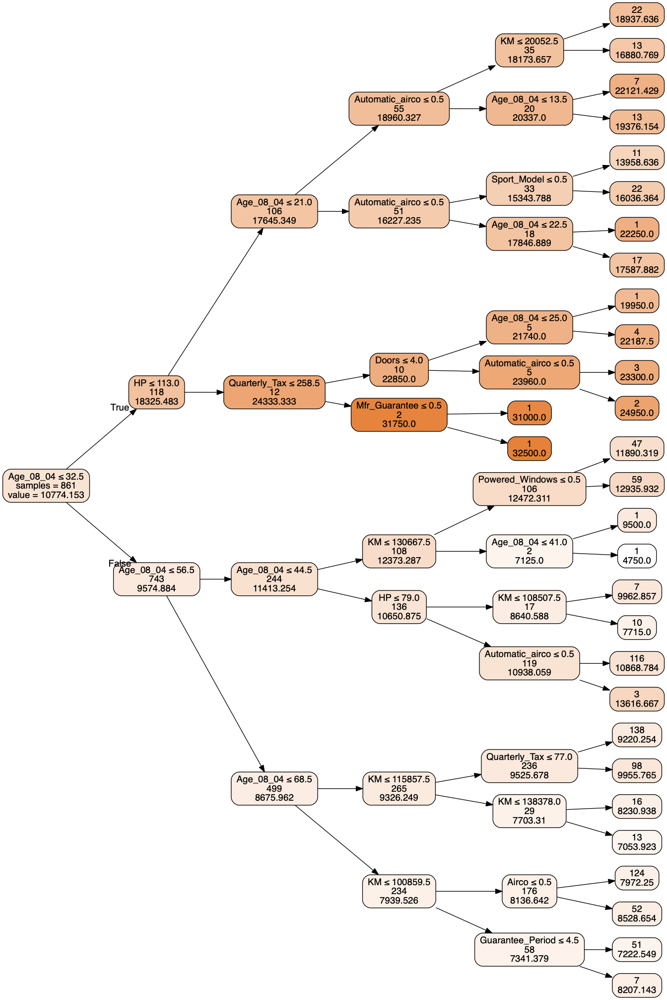

In [7]:
shallowTree = DecisionTreeRegressor(max_depth=5)
shallowTree.fit(train_X, train_y)
print('Tree has {} nodes'.format(shallowTree.tree_.node_count))
plotDecisionTree(shallowTree, feature_names=train_X.columns, rotate=True, impurity=False)

In [8]:
regressionSummary(train_y, shallowTree.predict(train_X))
regressionSummary(valid_y, shallowTree.predict(valid_X))


Regression statistics

                      Mean Error (ME) : -0.0000
       Root Mean Squared Error (RMSE) : 1028.0279
            Mean Absolute Error (MAE) : 773.2770
          Mean Percentage Error (MPE) : -1.0039
Mean Absolute Percentage Error (MAPE) : 7.6715

Regression statistics

                      Mean Error (ME) : 60.6683
       Root Mean Squared Error (RMSE) : 1155.6347
            Mean Absolute Error (MAE) : 909.8424
          Mean Percentage Error (MPE) : -0.6093
Mean Absolute Percentage Error (MAPE) : 9.2223


For the shallower tree, the RMSE values of training and validation sets are comparable. Compared to the deep tree, the RMSE of the validation set is lower. 
This shallower tree does much worse on the training set than the deep tree but does better in predicting rows in the validation set. This indicates a more robust model.

### Question 1c:
etermine an optimal set of parameters (<code>max_depth</code>, <code>min_impurity_decrease</code>, <code>min_samples_split</code>) using cross-validated grid search.

Initial parameters:  {'max_depth': 10, 'min_impurity_decrease': 0, 'min_samples_split': 20}
Improved parameters:  {'max_depth': 6, 'min_impurity_decrease': 0, 'min_samples_split': 21}
Tree has 61 nodes


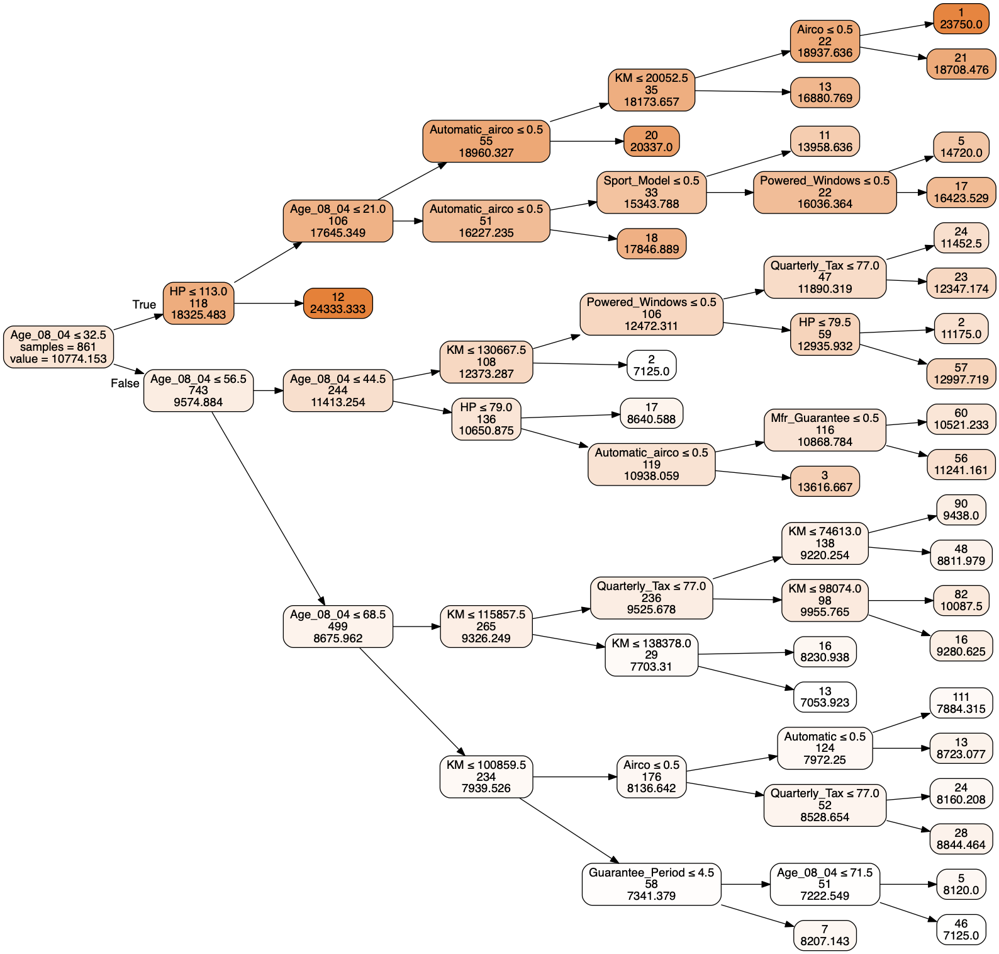

In [9]:
# user grid search to find optimized tree
param_grid = {
    'max_depth': [5, 10, 15, 20, 25], 
    'min_impurity_decrease': [0, 0.001, 0.005, 0.01], 
    'min_samples_split': [10, 20, 30, 40, 50], 
}
gridSearch = GridSearchCV(DecisionTreeRegressor(random_state=1), 
                          param_grid, cv=5, n_jobs=-1)
gridSearch.fit(train_X, train_y)
print('Initial parameters: ', gridSearch.best_params_)

param_grid = {
    'max_depth': [5, 6, 7, 8, 9, 10, 11, 12, 13], 
    'min_impurity_decrease': [0, 0.001, 0.002, 0.003, 0.004, 0.005, 
                              0.006, 0.007], 
    'min_samples_split': [17, 18, 19, 20, 21, 22, 23], 
}
gridSearch = GridSearchCV(DecisionTreeRegressor(random_state=1), 
                          param_grid, cv=5, n_jobs=-1)
gridSearch.fit(train_X, train_y)
print('Improved parameters: ', gridSearch.best_params_)

optRegTree = gridSearch.best_estimator_

importanceRT = pd.DataFrame({'features': train_X.columns, 
                             'importance': deepTree.feature_importances_})

print('Tree has {} nodes'.format(optRegTree.tree_.node_count))
plotDecisionTree(optRegTree, feature_names=train_X.columns, rotate=True)

### Question 1d:
What is the performance of the optimized model on the training and validation sets?

In [10]:
regressionSummary(train_y, optRegTree.predict(train_X))
regressionSummary(valid_y, optRegTree.predict(valid_X))


Regression statistics

                      Mean Error (ME) : 0.0000
       Root Mean Squared Error (RMSE) : 1100.9381
            Mean Absolute Error (MAE) : 799.4101
          Mean Percentage Error (MPE) : -1.0081
Mean Absolute Percentage Error (MAPE) : 7.6852

Regression statistics

                      Mean Error (ME) : 23.7040
       Root Mean Squared Error (RMSE) : 1240.2015
            Mean Absolute Error (MAE) : 950.0088
          Mean Percentage Error (MPE) : -1.0616
Mean Absolute Percentage Error (MAPE) : 9.5168


Based on this analysis, we could pick a decision tree of maximum depth 6. For this tree depth, the training set RMSE is 842 and the validation set RMSE 1237.

### Question 1e:
Predict the price of a used Toyota Corolla with the given specifications.

In [11]:
useCar_df = pd.DataFrame([{
    'Age_08_04': 77,
    'KM': 117000, 
    'Petrol': 1,
    'Diesel': 0,
    'HP': 110, 
    'Automatic': 0, 
    'Doors': 5, 
    'Quarterly_Tax': 100,
    'Mfr_Guarantee': 0, 
    'Guarantee_Period': 3, 
    'Airco': 1, 
    'Automatic_airco': 0,  
    'CD_Player': 0, 
    'Powered_Windows': 0, 
    'Sport_Model': 0, 
    'Tow_Bar': 1 
}])
optRegTree.predict(useCar_df)

array([8160.20833333])

The price of the used car is predicted to be 8160.

## Question2 - Decision Tree Classifier model
Let us see the effect of turning the price variable into a categorical variable. First, create a new variable that categorizes price into 20 bins. Now repartition the data keeping Binned Price instead of Price. Run a classification tree (CT) with
the same set of input variables as in the RT, and with Binned Price as the output variable. Set the model parameters so as to build a deep tree. The function <code>pandas.cut</code> can be used to bin your data.

Create a binned variable `binned_price` which categorizes Price into 20 bins and split the dataset into training and test sets.

In [12]:
car_df['binned_price'] = pd.cut(car_df.Price, 20, labels=False)
car_df.head(5)

X = car_df.drop(columns=['Price', 'binned_price'])
y = car_df['binned_price']

train_X, valid_X, train_y, valid_y = train_test_split(X, y, test_size=0.4, random_state=1)

Create a deep classification tree

In [13]:
deepClassTree = DecisionTreeClassifier(random_state=1)
deepClassTree.fit(train_X, train_y)

classNames = [str(s) for s in deepClassTree.classes_]

print("Classes: {}".format(', '.join(classNames)))
print('Tree has {} nodes'.format(deepClassTree.tree_.node_count))
plotDecisionTree(deepClassTree, feature_names=train_X.columns, 
                 class_names=classNames, impurity=False)

Classes: 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 18, 19
Tree has 779 nodes


Compared to the regression tree, this tree has fewer nodes. However, it is still very complex.

In [14]:
importance = pd.DataFrame({'features': train_X.columns, 
                           'importance': deepClassTree.feature_importances_})
importance.sort_values(by='importance', ascending=False)

,features,importance
0,Age_08_04,0.321882
1,KM,0.294123
5,Quarterly_Tax,0.064955
2,HP,0.045970
6,Mfr_Guarantee,0.038950
13,Tow_Bar,0.037084
4,Doors,0.036025
12,Sport_Model,0.030811
11,Powered_Windows,0.028198
8,Airco,0.027394


In contrast to the regression tree, `Age_08_04` and `KM` have now similar importance. `Automatic_airco` is no longer in the top-3, however the difference between the next variables is very small and their order will depend on the training and validation split as well as the random selection of variables for splitting if two or more variables lead to the same impurity improvement.

In [15]:
classificationSummary(train_y, deepClassTree.predict(train_X))
classificationSummary(valid_y, deepClassTree.predict(valid_X))

Confusion Matrix (Accuracy 1.0000)

       Prediction
Actual   0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16
     0   4   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
     1   0  62   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
     2   0   0 179   0   0   0   0   0   0   0   0   0   0   0   0   0   0
     3   0   0   0 251   0   0   0   0   0   0   0   0   0   0   0   0   0
     4   0   0   0   0 109   0   0   0   0   0   0   0   0   0   0   0   0
     5   0   0   0   0   0  83   0   0   0   0   0   0   0   0   0   0   0
     6   0   0   0   0   0   0  58   0   0   0   0   0   0   0   0   0   0
     7   0   0   0   0   0   0   0  14   0   0   0   0   0   0   0   0   0
     8   0   0   0   0   0   0   0   0  32   0   0   0   0   0   0   0   0
     9   0   0   0   0   0   0   0   0   0  13   0   0   0   0   0   0   0
    10   0   0   0   0   0   0   0   0   0   0  23   0   0   0   0   0   0
    11   0   0   0   0   0   0   0   0   0   0

The accuracy of the training set is 1 and for the validation set 0.41.

### Question 2a:
Use cross-validated grid search to determine an optimal set of parameters.

In [16]:
# user grid search to find optimized tree
param_grid = {
    'max_depth': [5, 10, 15, 20, 25], 
    'min_impurity_decrease': [0, 0.001, 0.005, 0.01], 
    'min_samples_split': [10, 20, 30, 40, 50], 
}
gridSearch = GridSearchCV(DecisionTreeClassifier(random_state=1), param_grid, cv=5, n_jobs=-1)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    gridSearch.fit(train_X, train_y)
print('Initial parameters: ', gridSearch.best_params_)

param_grid = {
    'max_depth': [1, 2, 3, 4, 5, 6, 7, 8], 
    'min_impurity_decrease': [0, 0.001, 0.002, 0.003, 0.004, 0.005, 0.006, 0.007], 
    'min_samples_split': [8, 9, 10, 11, 12, 13], 
}
gridSearch = GridSearchCV(DecisionTreeClassifier(random_state=1), param_grid, cv=5, n_jobs=-1)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    gridSearch.fit(train_X, train_y)
print('Improved parameters: ', gridSearch.best_params_)

optClassTree = gridSearch.best_estimator_
importanceCT = pd.DataFrame({'features': train_X.columns, 
                             'importance': optClassTree.feature_importances_})


Initial parameters:  {'max_depth': 5, 'min_impurity_decrease': 0, 'min_samples_split': 10}
Improved parameters:  {'max_depth': 5, 'min_impurity_decrease': 0, 'min_samples_split': 12}


Tree has 57 nodes


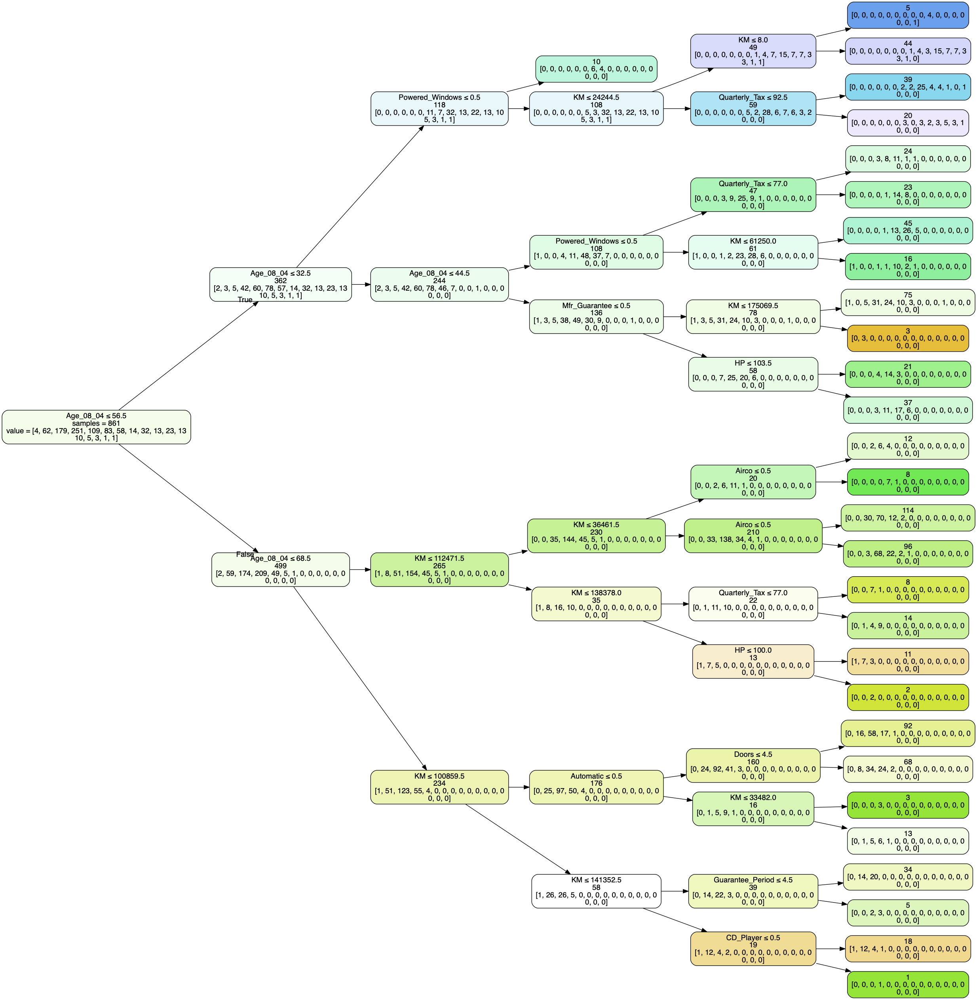

In [17]:
print('Tree has {} nodes'.format(optClassTree.tree_.node_count))
plotDecisionTree(optClassTree, feature_names=train_X.columns, rotate=True)

In [18]:
classificationSummary(train_y, optClassTree.predict(train_X))
classificationSummary(valid_y, optClassTree.predict(valid_X))

Confusion Matrix (Accuracy 0.5738)

       Prediction
Actual   0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16
     0   0   2   0   1   0   1   0   0   0   0   0   0   0   0   0   0   0
     1   0  22  38   2   0   0   0   0   0   0   0   0   0   0   0   0   0
     2   0   7 121  51   0   0   0   0   0   0   0   0   0   0   0   0   0
     3   0   1  42 197   4   7   0   0   0   0   0   0   0   0   0   0   0
     4   0   0   3  63  21  21   1   0   0   0   0   0   0   0   0   0   0
     5   0   0   0  14   4  52  13   0   0   0   0   0   0   0   0   0   0
     6   0   0   0   4   0  17  32   0   2   0   0   3   0   0   0   0   0
     7   0   0   0   0   0   2   9   0   2   0   1   0   0   0   0   0   0
     8   0   0   0   0   0   0   0   0  25   0   4   3   0   0   0   0   0
     9   0   0   0   0   0   0   0   0   4   4   3   2   0   0   0   0   0
    10   0   0   0   1   0   0   0   0   4   0  15   3   0   0   0   0   0
    11   0   0   0   0   0   0   0   0   1   0

The accuracies for the shallow classification tree are 0.57 and 0.48. 

The cross validation results suggest to pick a maximum tree depth of 5. At this depth, the accuracy on the training (0.57) and validation sets (0.48) are comparable.

### Question 2b:
Compare the tree generated by the CT with the one generated by the RT. Are they different? (Look at structure, the top predictors, size of tree, etc.) Why?

Overall, the two trees have similar complexity. The regression tree has 26 terminal nodes (51 nodes in total). Only 10 of these nodes are at the maximum depth of 6. The top-3 most important predictors are, Age, HP, and KM.

Classification tree has 29 terminal nodes (57 nodes in total). All but one of the terminal nodes is at the maximum depth of 5. The top-3 most important predictors are, Age, KM, and Quarterly_Tax. In contrast to the regression tree, HP is less important. 

RT: 'max_depth': 6, 'min_impurity_decrease': 0.007, 'min_samples_split': 17
DT: 'max_depth': 5, 'min_impurity_decrease': 0, 'min_samples_split': 12

In [19]:
importanceRT.sort_values(by='importance', ascending=False).head(5)

,features,importance
0,Age_08_04,0.844867
2,HP,0.053789
1,KM,0.049601
9,Automatic_airco,0.013358
5,Quarterly_Tax,0.006769


In [20]:
importanceCT.sort_values(by='importance', ascending=False).head(5)

,features,importance
0,Age_08_04,0.614901
1,KM,0.193525
5,Quarterly_Tax,0.043403
11,Powered_Windows,0.039055
8,Airco,0.029699


### Question 2c:
Predict the price, using the RT and the CT, of a used Toyota Corolla with the given specification.

In [21]:
print(optClassTree.predict(useCar_df))
pd.cut(car_df.Price, 20).cat.categories[optClassTree.predict(useCar_df)]

[2]


IntervalIndex([(7165.0, 8572.5]],
              closed='right',
              dtype='interval[float64]')

The optimal tree predicts the car price to be in bin 2 which corresponds to a price range of 7165 to 8572. 

## Comparison of the results

From the classification tree we get a range for the predicted price whereas the regression tree gives a predicted fixed price.

You do lose accuracy by binning the price. So depending on the application, regression tree or classification tree would be selected.

For example, if your purpose were simply to set an initial sticker price at which to sell the car (i.e., estimation), regression tree would be a good choice. On the other hand, if your purpose were to determine whether the car falls above or below a set cutoff (say, for inclusion in an offering to a volume buyer who will not pay more than a certain amount per car), classification tree will focus on developing rules for that particular price point and might work better.